In [1]:
import os
os.chdir("../")

In [2]:
import json
import pickle
from collections import defaultdict
from pathlib import Path
from importlib import reload
import collections.abc as container_abcs

import cv2
import numpy as np
import albumentations as A
from matplotlib import pyplot as plt

from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.data.datasets import register_coco_instances

from src.utils.config import load_config
from src.data_operations import data_augmentation_ops
from src.data_operations import coco_labels_ops
from src.utils.detectron_utils import plot_samples, get_train_cfg, predict

import torch
torch.cuda.empty_cache()

c:\Users\marce\miniconda3\envs\tfg2\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
global_config, local_config = load_config()

In [4]:
DATA_AUGMENTATION = False
NUM_ROUNDS = 10
UNICLASS = False
TRAINING = False
MODEL_FOLDER_NAME = "detectron2\\c1_t7_it5000_l001\\"

#### DATA PREPARATION
- Convert labels to uniclass(for the moment)
- Optional data augmentation

In [5]:
with open(
    Path(local_config["PATH"]["coco_labels"]).joinpath("train_transformed.json")
) as file:
    coco_train_labels = json.load(file)

with open(
    Path(local_config["PATH"]["coco_labels"]).joinpath(local_config["FILENAMES"]["coco_test_labels"])
) as file:
    coco_test_labels = json.load(file)

In [6]:
coco_train_labels.keys()

dict_keys(['annotations', 'categories', 'images', 'info', 'licenses'])

DATA AUGMENTATION

In [7]:

if DATA_AUGMENTATION:
    
    num_images = len(coco_train_labels["images"])
    annotations = defaultdict(list, [])
    images = {}
    
    for annot in coco_train_labels["annotations"]:
        annotations[annot["image_id"]].append(annot)

    for img in coco_train_labels["images"]:
        images[img["id"]] = img
        
    last_annot_id = coco_train_labels["annotations"][-1]["id"]+1
    last_image_id = 100000
    
    t_images = images.copy()
    t_annotations = annotations.copy()
    
    for i in range(NUM_ROUNDS):
        for key, values in images.items():
            filename = values["file_name"]
            image = cv2.cvtColor(
                cv2.imread(
                    local_config["PATH"]["coco_routes"]
                    +filename
                ),
                cv2.COLOR_BGR2RGB,
            )
            
            masks = [annot["segmentation"] for annot in annotations[key]]
            bbox = [annot["bbox"] for annot in annotations[key]]
            labels = [annot["category_id"] for annot in annotations[key]]
            
            print(f"BEFORE T IM{key}: Masks {len(masks)}, Boxes {len(bbox)}")
            
            numpy_masks = coco_labels_ops.coco_polygons_to_numpy_masks(
                masks, image.shape[:2]
            )
            
            t_image, t_masks, t_bbox, t_labels = data_augmentation_ops.apply_transform(
                image, numpy_masks, bbox, labels
            )
            
            print(f"AFTER T IM{key}: Masks {len(t_masks)}, Boxes {len(t_bbox)}")

            
            t_masks = coco_labels_ops.numpy_masks_to_coco_polygons(t_masks)
            
            annotations_copy = []
            
            print(f"AFTER TT IM{key}: Masks {len(t_masks)}, Boxes {len(t_bbox)}")
            for j in range(len(t_masks)):
                annot_copy = {}
                annot_copy["area"] = 0
                annot_copy["bbox"] = list(t_bbox[j])
                annot_copy["category_id"] = t_labels[j]
                annot_copy["id"] = last_annot_id
                annot_copy["image_id"] =  last_image_id
                annot_copy["iscrowd"] = 0
                annot_copy["segmentation"] = t_masks[j]

                annotations_copy.append(annot_copy)
                last_annot_id += 1
            
            img_copy = values.copy()
            img_copy["id"] = last_image_id
            img_copy["file_name"] = str(last_image_id)+".jpg"
            img_copy["width"] = t_image.shape[1]
            img_copy["height"] = t_image.shape[0]
            
            cv2.imwrite(
                local_config["PATH"]["coco_routes"] + img_copy["file_name"],
                t_image, 
            )
            
            
            t_annotations[str(last_image_id)] = annotations_copy
            t_images[str(last_image_id)] = img_copy
            
            last_image_id += 1
            
        print(f"Round {i} done!")
    
    
    coco_train_labels_transformed = coco_train_labels.copy()
    coco_train_labels_transformed["annotations"] = [subitem for item in list(t_annotations.values()) for subitem in item]
    coco_train_labels_transformed["images"] = [item for item in list(t_images.values())]
    
    with open(local_config["PATH"]["coco_labels"]+"train_transformed.json", mode="w", encoding="utf-8") as f:
        json.dump(coco_train_labels_transformed, f, ensure_ascii=False, indent=4)
        
    with open(
        Path(local_config["PATH"]["coco_labels"]).joinpath("train_transformed.json")
    ) as file:
        coco_train_labels = json.load(file)

CONVERTING ALL LABELS TO SAME CLASS FOR INITIAL SIMPLICITY

In [8]:
if UNICLASS:
    local_config["FILENAMES"]["coco_train_labels"] = "train_uniclass.json"
    local_config["FILENAMES"]["coco_test_labels"] = "test_uniclass.json"

    for dataset in [coco_train_labels, coco_test_labels]:
        annotations = []
        for annotation in dataset["annotations"]:
            annotation["category_id"] = 1
            annotations.append(annotation)
        dataset["annotations"] = annotations
        dataset["categories"] = [dataset["categories"][0]]
        
    with open(local_config["PATH"]["coco_labels"]+local_config["FILENAMES"]["coco_train_labels"], mode="w", encoding="utf-8") as f:
        json.dump(coco_train_labels, f, ensure_ascii=False, indent=4)
    with open(local_config["PATH"]["coco_labels"]+local_config["FILENAMES"]["coco_test_labels"], mode="w", encoding="utf-8") as f:
        json.dump(coco_test_labels, f, ensure_ascii=False, indent=4)

DETECTRON2 CONFIGURATION

In [9]:
config_file_path = "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
checkpoint_url = "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
cfg_save_path = local_config["PATH"]["config"]+"hold-detector_cfg.pickle"
output_dir = local_config["PATH"]["models"]+"instance_segmentation\\"+MODEL_FOLDER_NAME
num_classes = 1 if UNICLASS else 2
device = "cuda"
train_dataset_name = "hold_detector_train"
train_images_path = local_config["PATH"]["coco_routes"]
train_annotations_path = local_config["PATH"]["coco_labels"]+local_config["FILENAMES"]["coco_train_labels"]
test_dataset_name = "hold_detector_test"
test_images_path = local_config["PATH"]["coco_routes"]
test_annotations_path = local_config["PATH"]["coco_labels"]+local_config["FILENAMES"]["coco_test_labels"]

In [10]:
register_coco_instances(
    name = train_dataset_name,
    metadata = {},
    json_file = train_annotations_path,
    image_root = train_images_path,
)
register_coco_instances(
    name = test_dataset_name,
    metadata = {},
    json_file = test_annotations_path,
    image_root = test_images_path,
)

In [11]:
cfg = get_train_cfg(
    config_file_path=config_file_path,
    checkpoint_url=checkpoint_url,
    train_dataset_name=train_dataset_name,
    test_dataset_name=test_dataset_name,
    n_classes=num_classes,
    device=device,
    output_dir=output_dir
)
with open(cfg_save_path, "wb") as f:
    pickle.dump(cfg, f, protocol=pickle.HIGHEST_PROTOCOL)

data\\preprocessed\\COCO\\labels\\train.json contains 4445 annotations, but only 4440 of them match to images in the file.


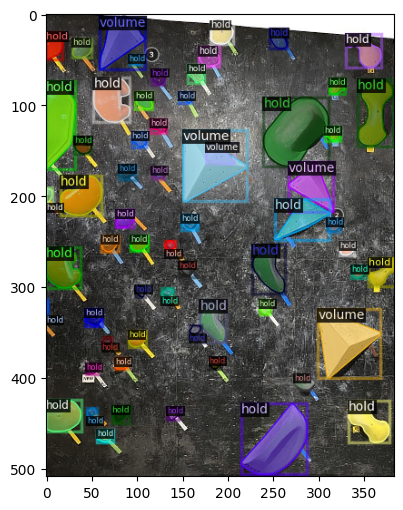

In [12]:
plot_samples(train_dataset_name, n_images=1, image_size=(6,6))

TRAINING

In [13]:
len(coco_train_labels["images"])

1199

In [14]:
if TRAINING:
    trainer = DefaultTrainer(cfg)
    trainer.resume_or_load(resume=False)
    trainer.train()

In [18]:
with open(cfg_save_path, mode="rb") as f:
    cfg = pickle.load(f)
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.4
predictor = DefaultPredictor(cfg)

Shape of roi_heads.box_predictor.bbox_pred.bias in checkpoint is torch.Size([4]), while shape of roi_heads.box_predictor.bbox_pred.bias in model is torch.Size([8]).
roi_heads.box_predictor.bbox_pred.bias will not be loaded. Please double check and see if this is desired.
Shape of roi_heads.box_predictor.bbox_pred.weight in checkpoint is torch.Size([4, 1024]), while shape of roi_heads.box_predictor.bbox_pred.weight in model is torch.Size([8, 1024]).
roi_heads.box_predictor.bbox_pred.weight will not be loaded. Please double check and see if this is desired.
Shape of roi_heads.box_predictor.cls_score.bias in checkpoint is torch.Size([2]), while shape of roi_heads.box_predictor.cls_score.bias in model is torch.Size([3]).
roi_heads.box_predictor.cls_score.bias will not be loaded. Please double check and see if this is desired.
Shape of roi_heads.box_predictor.cls_score.weight in checkpoint is torch.Size([2, 1024]), while shape of roi_heads.box_predictor.cls_score.weight in model is torch.Si

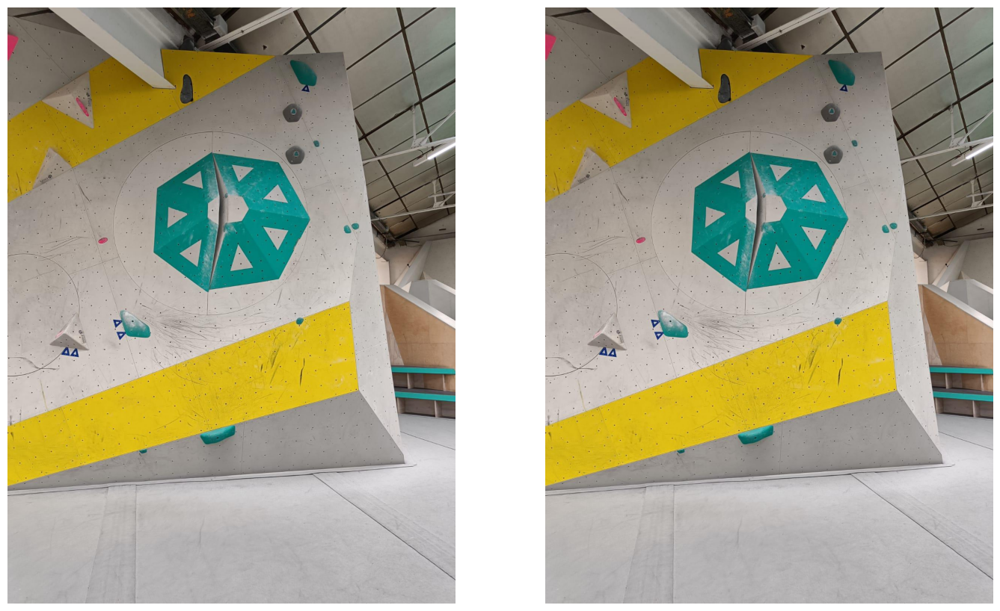

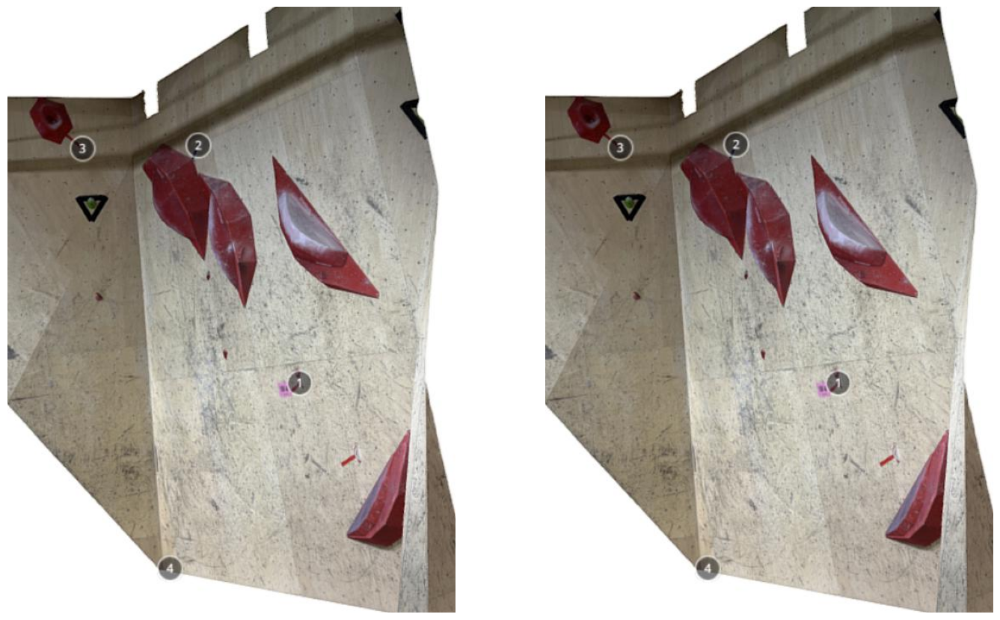

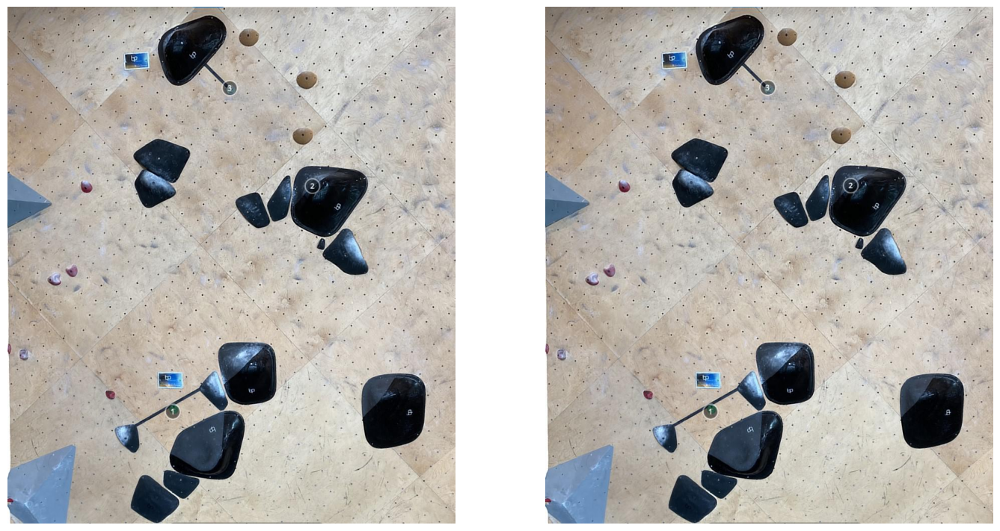

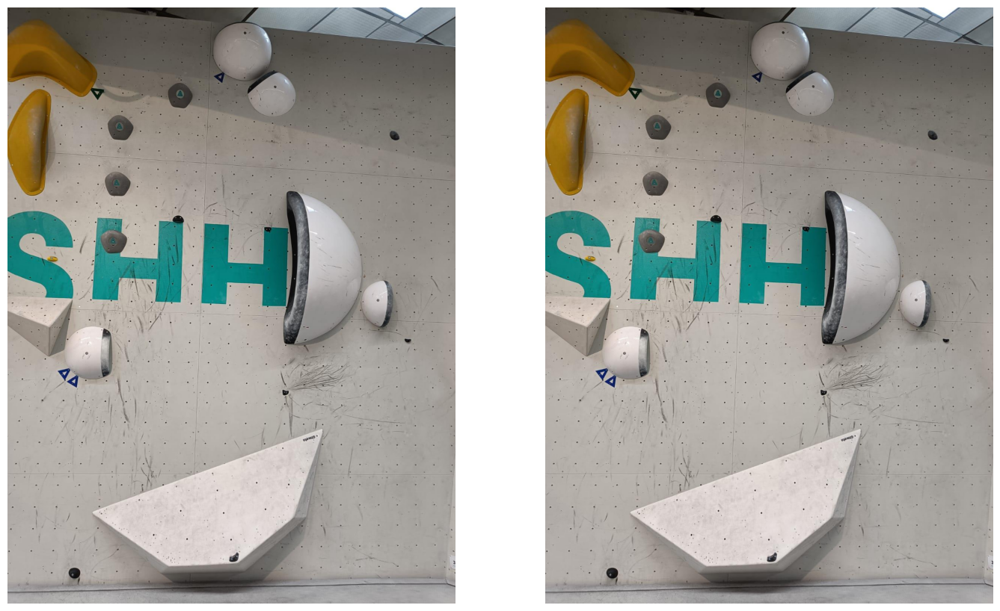

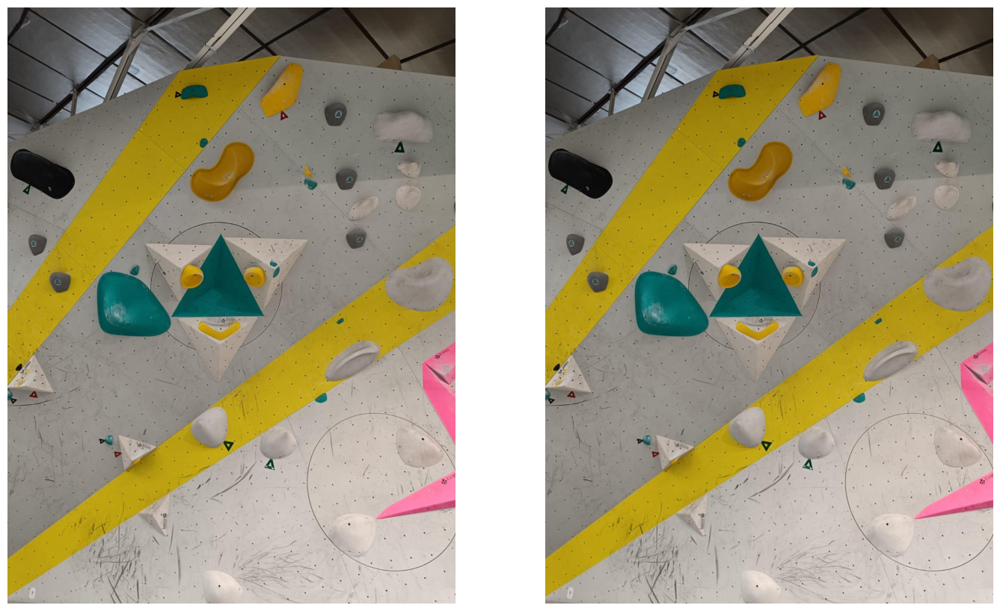

...

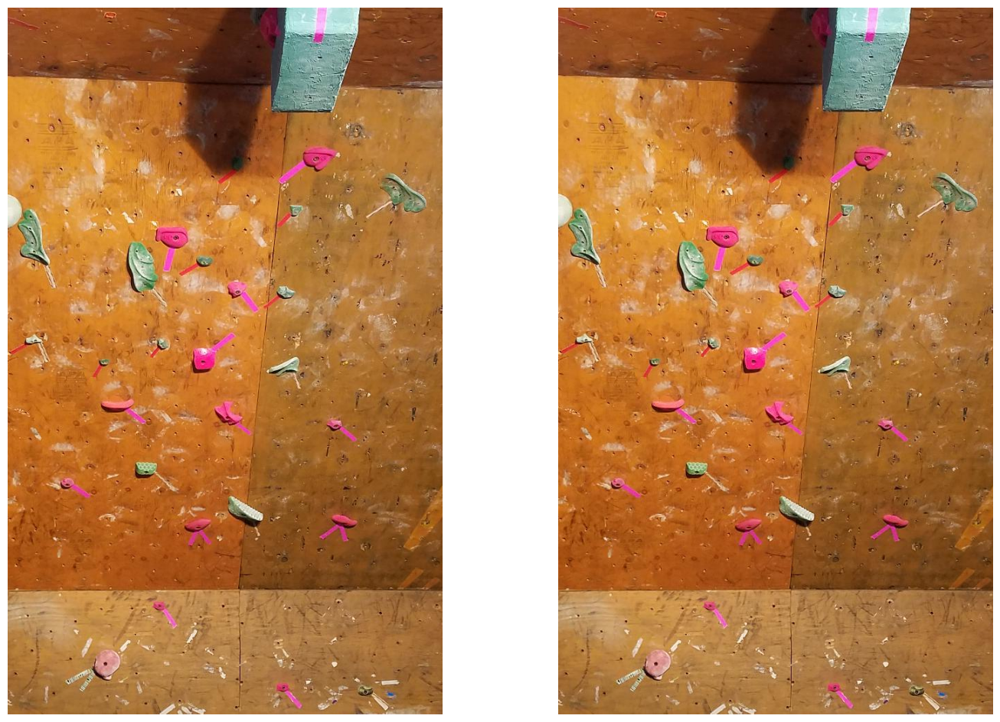

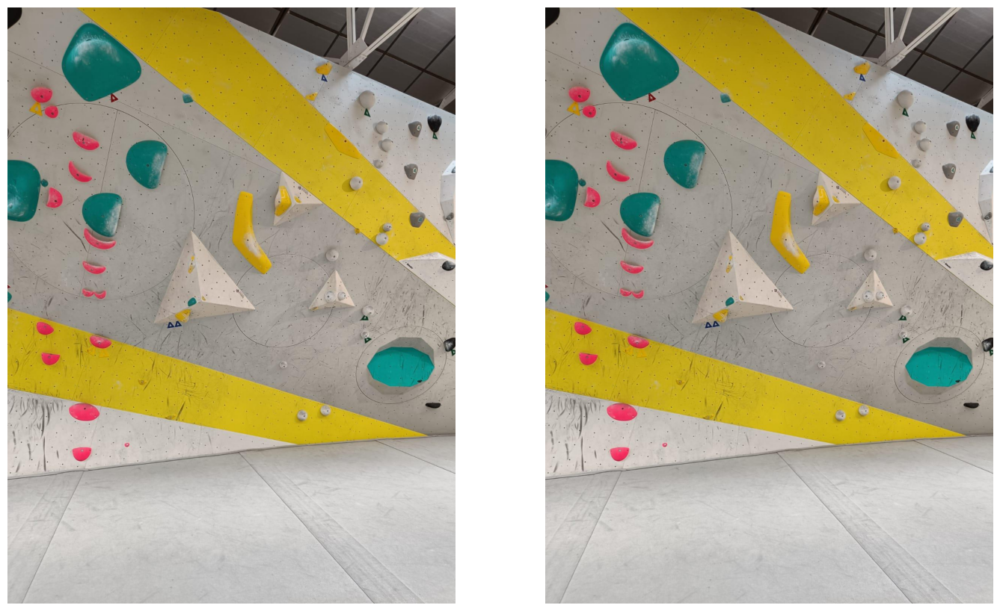

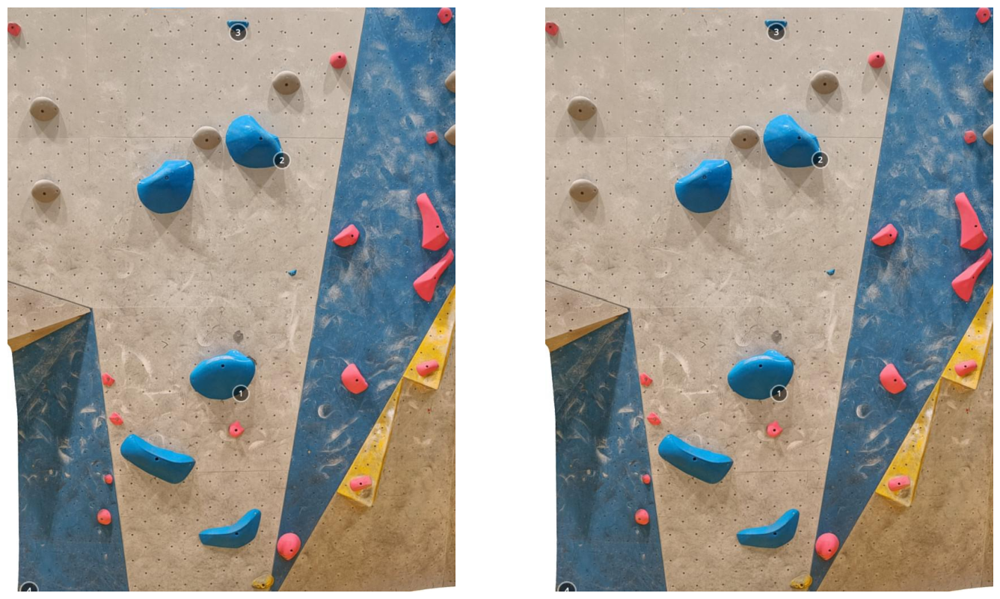

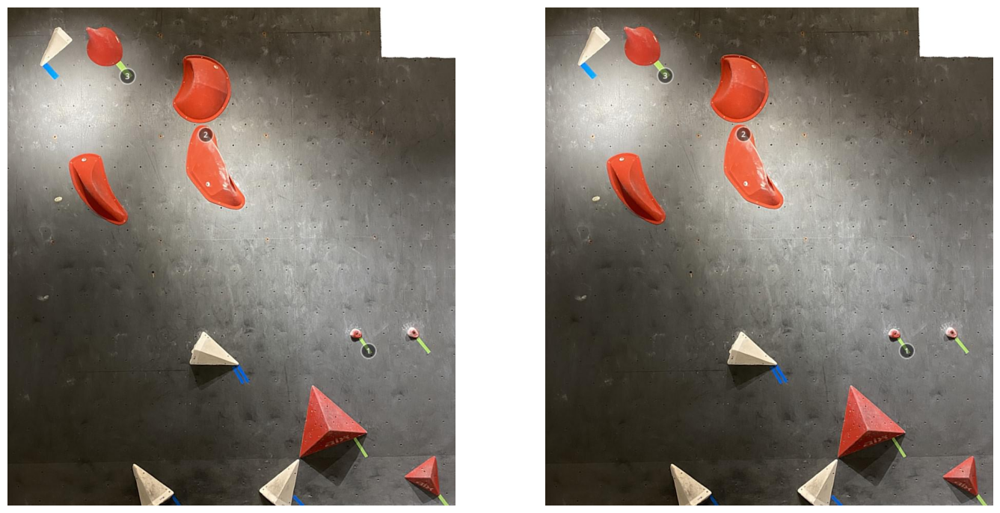

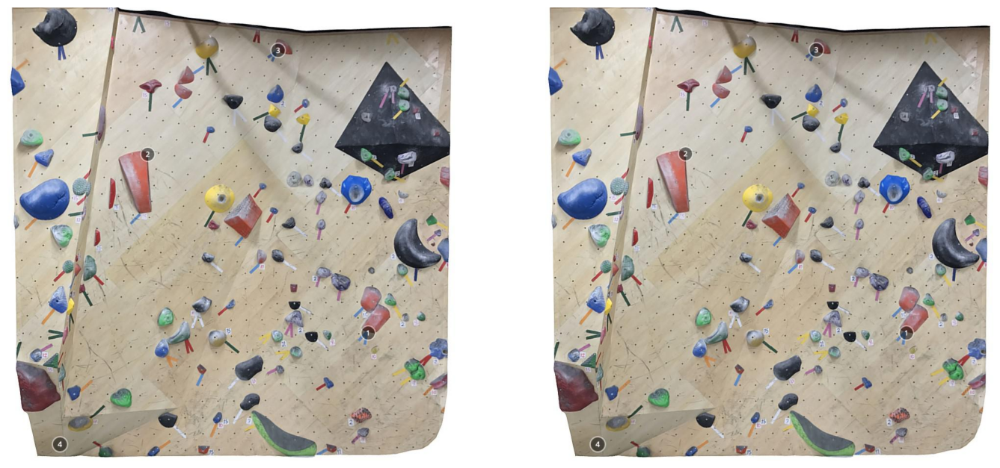

In [19]:
for image in coco_test_labels["images"]:
    image_file = image["file_name"]
    image_original = cv2.imread(local_config["PATH"]["coco_routes"]+image_file)
    predicted_image = predict(
        local_config["PATH"]["coco_routes"]+image_file,
        predictor,
    )

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,12))
    ax1.imshow(image_original[:,:,::-1])
    ax1.axis("off")
    ax2.imshow(predicted_image)
    ax2.axis("off")
    plt.show()

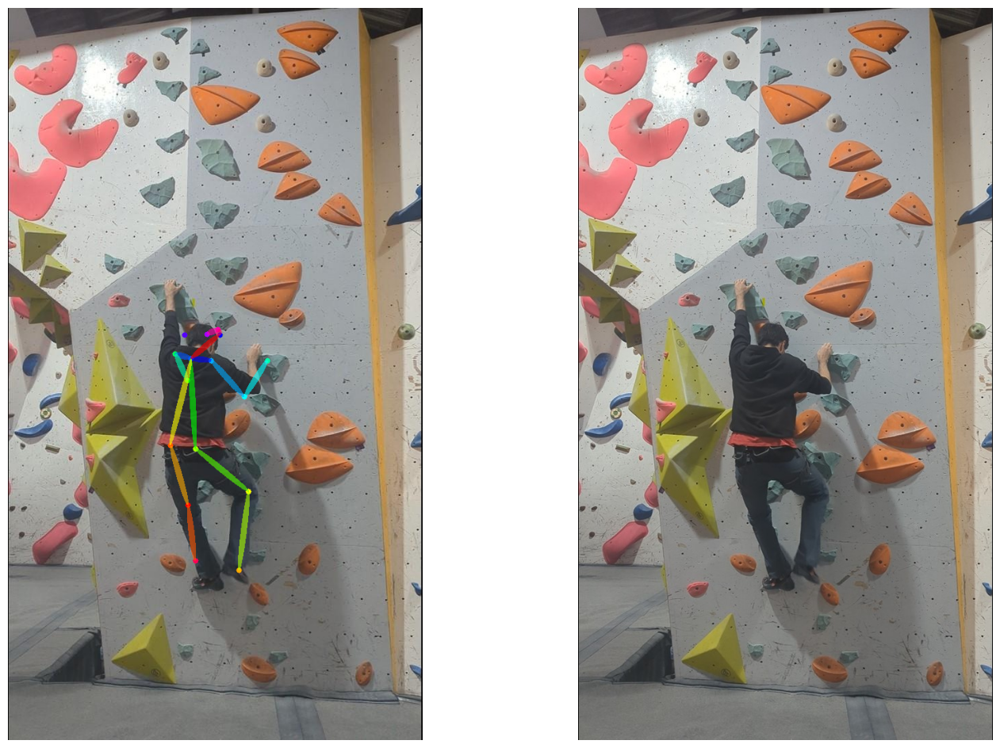

In [17]:
from detectron2.utils.visualizer import Visualizer, ColorMode
hold_file = "vidal_test.jpg"
pose_file = cv2.imread(local_config["PATH"]["coco_routes"]+"vidal_test_est.png")

im = local_config["PATH"]["coco_routes"]+hold_file
predicted_image = predict(im, predictor)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,12))
ax1.imshow(pose_file[:,:,::-1])
ax1.axis("off")
ax2.imshow(predicted_image)
ax2.axis("off")
plt.show()

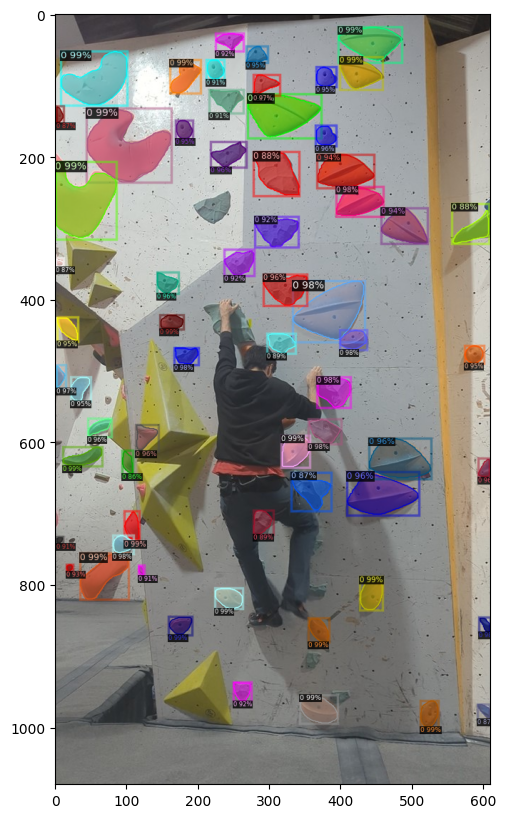

In [18]:
test_file = "vidal_test.jpg"

im = local_config["PATH"]["coco_routes"]+test_file
predicted_image = predict(im, predictor)

fig = plt.figure(figsize=(15,10))
plt.imshow(predicted_image)
plt.show()

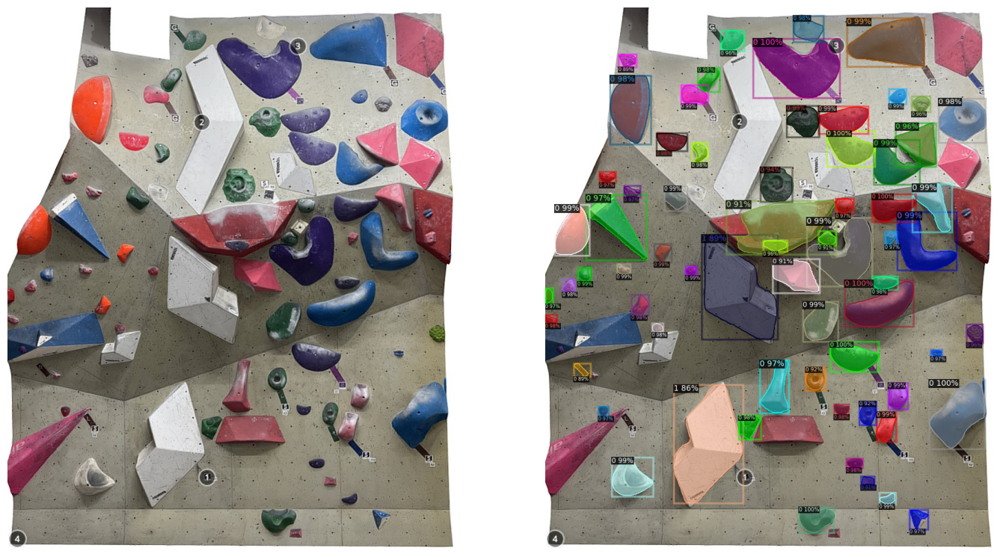

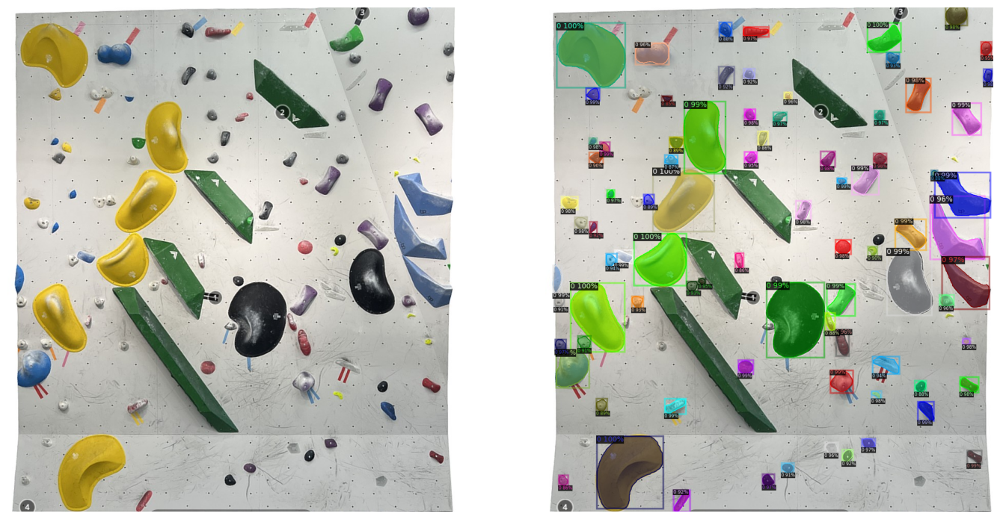

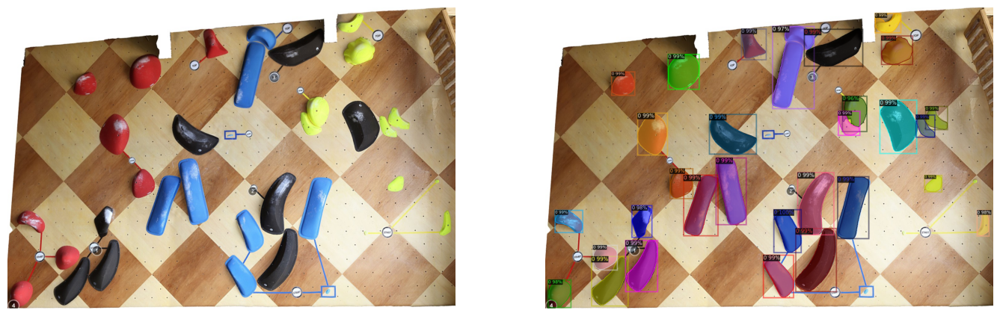

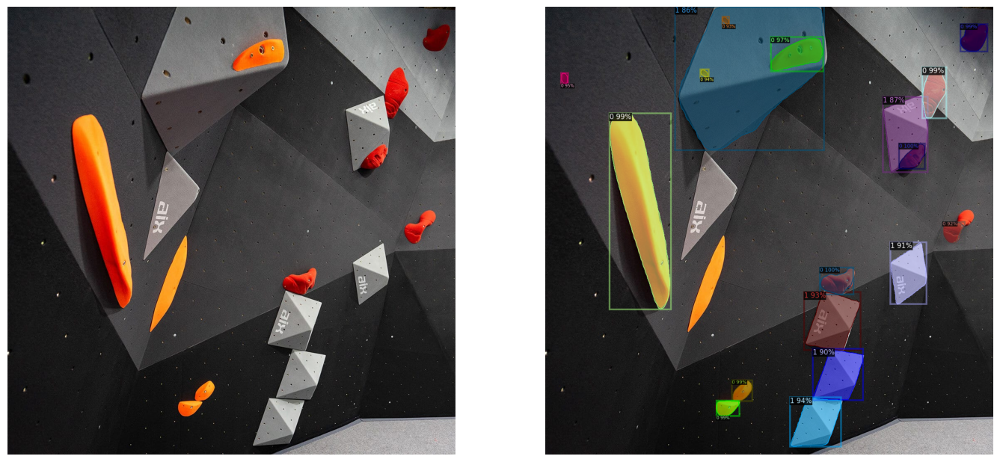

[02/03 19:11:56 d2.utils.memory]: Attempting to copy inputs of <function paste_masks_in_image at 0x0000026276EB3820> to CPU due to CUDA OOM


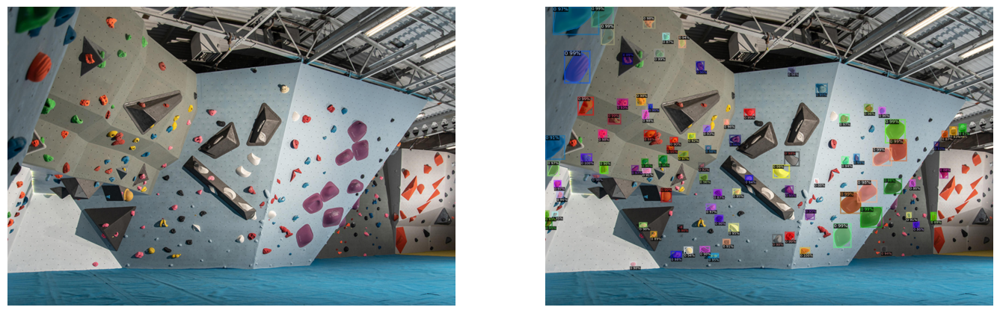

In [19]:
path = Path(local_config["PATH"]["raw_routes"]).joinpath("test_set/")
files = os.listdir(path)
for f in files:
    image_file = f
    image_original = cv2.imread(str(path.joinpath(image_file)))
    predicted_image = predict(
        str(path.joinpath(image_file)),
        predictor,
    )

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,12))
    ax1.imshow(image_original[:,:,::-1])
    ax1.axis("off")
    ax2.imshow(predicted_image)
    ax2.axis("off")
    plt.show()